## Multiple Linear Regression

---
- In the previous chapter we learned about predicting the output (Y) for  single  input (X).
- In this chapter, we are going to learn about predicting the output (Y) for  multiple inputs ($X_n$)


---
Example : Predicting the price of house  (Y) on the basis of multiple input : $X_1$  Nummber of bedrooms ,  $X_2$ age of property ,  $X_3$ size of property . 


### Comparision between Single and multiple Linear Regression 

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
import plotly.graph_objects as go
from IPython.display import display, HTML

# Set random seed
np.random.seed(42)

# -----------------------------
# Generate synthetic data
# -----------------------------
n_samples = 100
land_area = np.random.uniform(3.0, 6.0, n_samples)  # aana (≥ 3)
rooms = np.random.randint(1, 8, n_samples)

cost_per_room = 7.5
cost_per_aana = 25

land_cost = cost_per_aana * land_area + np.random.normal(0, 8, n_samples)
building_cost = cost_per_room * rooms + np.random.normal(0, 3, n_samples)
total_cost = land_cost + building_cost

# -----------------------------
# Simple Linear Regression
# -----------------------------
simple_model = LinearRegression()
simple_model.fit(land_area.reshape(-1, 1), land_cost)

x_land = np.linspace(3, 6, 100)
y_pred = simple_model.predict(x_land.reshape(-1, 1))

# Save simple regression plot as image
fig1, ax = plt.subplots(figsize=(6, 5))
ax.scatter(land_area, land_cost, color='purple', alpha=0.6, label='Data')
ax.plot(x_land, y_pred, color='black', label='Fitted Line')
ax.set_xlabel("Land Area (Aana)")
ax.set_ylabel("Land Cost (Lakh NRS)")
ax.set_title("Simple Linear Regression")
ax.legend()
ax.grid(True)
fig1.tight_layout()
fig1.savefig("simple_plot.png")  # Save figure
plt.close(fig1)  # Close to prevent duplicate rendering

# -----------------------------
# Multiple Linear Regression (Interactive)
# -----------------------------
X_multi = np.column_stack((rooms, land_area))
multi_model = LinearRegression()
multi_model.fit(X_multi, total_cost)

room_grid, land_grid = np.meshgrid(np.linspace(1, 8, 30), np.linspace(3, 6, 30))
grid_points = np.column_stack((room_grid.ravel(), land_grid.ravel()))
Z_pred = multi_model.predict(grid_points).reshape(room_grid.shape)

fig2 = go.Figure()

fig2.add_trace(go.Scatter3d(
    x=rooms,
    y=land_area,
    z=total_cost,
    mode='markers',
    marker=dict(size=5, color='blue', opacity=0.7),
    name='Data Points'
))

fig2.add_trace(go.Surface(
    x=room_grid,
    y=land_grid,
    z=Z_pred,
    colorscale='YlOrRd',
    opacity=0.7,
    name='Regression Surface',
    showscale=False
))

fig2.update_layout(
    scene=dict(
        xaxis_title='Rooms',
        yaxis_title='Land (Aana)',
        zaxis_title='Total Cost (Lakh)'
    ),
    title='Multiple Linear Regression',
    margin=dict(l=0, r=0, b=0, t=30)
)

# -----------------------------
# Side-by-side display in Jupyter Notebook
# -----------------------------
display(HTML(f"""
<div style="display: flex; justify-content: space-around; align-items: flex-start;">
  <div style="width: 45%;">
    <img src="simple_plot.png" style="width: 100%; border:1px solid #ccc;" />
  </div>
  <div style="width: 50%;">
    {fig2.to_html(include_plotlyjs='cdn', full_html=False)}
  </div>
</div>
"""))


- In 1 input problem $m$  and $c$ are evaluated to represent a line in the 2D space.  
    
- In 2 input problem $m_1$ ,$m_2$ and $c$ are evaluated to represent a 2D plane in the 3D space.


#### For 3 or more input features.
-For 3 input problem we need to evaluate ($m_1$ ,$m_2$ ,$m_3$ and $c$ )to represent  3D hyper- plane  in a 4dimensional space .  
-Similary for more than 3  input features.  
-Although it is not visualizable we can evaluate best fit  $m_1$ , $m_2$ , $m_3 $ ..... $m_n$ according to the number of input features  $X_n$

<a href="https://www.flickr.com/photos/200947226@N07/54464499404/in/dateposted-public/" title="ChatGPT Image Apr 21, 2025, 12_16_59 AM">
  <img src="https://live.staticflickr.com/65535/54464499404_b5a47c914f_h.jpg" height = '100' width ='200' alt="ChatGPT Image Apr 21, 2025, 12_16_59 AM"/>
</a>



The process of evalulating  best fit  $m_1$ , $m_2$ , $m_3 $ ..... $m_n$ and $c$ is same as that of Simple Linear Regression.  
$i.e$ Minimizing the Sum of Squared Error.  

For one  variable $m_1$  
$Step 1$ : Evaluation of partial derivative of SSE with respect to $m_1$   
        Partial Derivative of  SSE with respect to  $m_1$ is given by :  
        
$P$= $\frac{\partial }{\partial m_1 }SSE$   

$P$= $\frac{\partial }{\partial m_1 }\sum(y-(m_1 *x_1+ m_2*x_2+ ...... m_n*x_n +c))^2$   
  ( Here Summation deontes this opeartion to be performed for each data point and all outputs are added )  
$P$= $\sum\frac{\partial }{\partial m_1}(y-(m_1 *x_1+ m_2*x_2+ ...... m_n*x_n +c))^2 $   
$P$= $ \sum2(y-(m_1 *x_1+ m_2*x_2+ ...... m_n*x_n +c) )(-x_1) $

$Step 2$: Make small step   
   $new$ $m_1$ = $m_1$ + $k$* $P$
   where k is constant called step size. As the name suggests it determine the size of  each step .   

$Step 3$: Step 1 and 2 are performed for each variables $m_1$ , $m_2$ , $m_3 $ ..... $m_n$ and $c$ .  

$Step 4$: Step 1 ,2,3  repetedly until $P$ attends value almost near to zero for each variables $m_1$ , $m_2$ , $m_3 $ ..... $m_n$ and $c$  .   
 

   

   

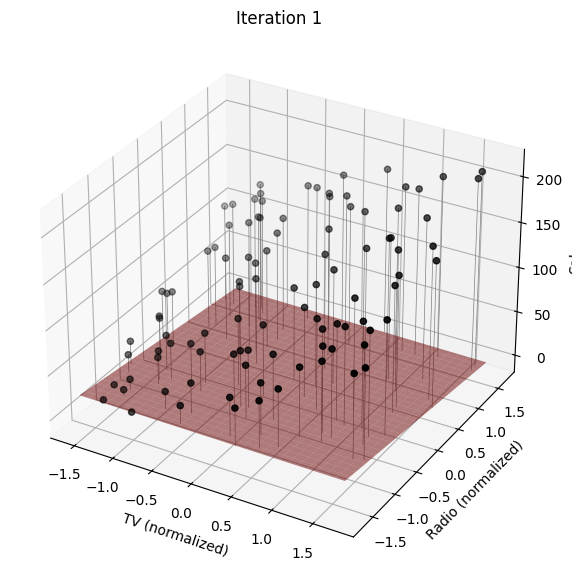

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import HTML

# Create synthetic data with a higher gradient
np.random.seed(42)
n = 100  # number of data points
X1 = np.random.rand(n) * 10  # TV spending (0 to 10)
X2 = np.random.rand(n) * 10  # Radio spending (0 to 10)

# Increased coefficients for a higher gradient
Y = 3 + 10 * X1 + 12 * X2 + np.random.randn(n) * 2  # Higher gradient for both X1 and X2

# Normalize features
X1 = (X1 - X1.mean()) / X1.std()
X2 = (X2 - X2.mean()) / X2.std()
Y = Y

# Design matrix for plane: [1, X1, X2]
X = np.c_[np.ones(X1.shape), X1, X2]

# Initialize weights to tilt the plane in the opposite direction
# This will tilt the plane initially in the opposite direction
w = np.array([5, -2, -10])  # b0=5, b1=-2, b2=-10 (change b1 and b2 for the opposite tilt)

# Hyperparameters
alpha = 0.05
iterations = 100

# To record parameter updates
w_history = []

# Gradient Descent
for _ in range(iterations):
    y_pred = X @ w
    error = y_pred - Y
    gradient = X.T @ error / len(Y)
    w = w - alpha * gradient
    w_history.append(w.copy())

# Create meshgrid for plotting surface
x1_surf, x2_surf = np.meshgrid(np.linspace(X1.min(), X1.max(), 30),
                               np.linspace(X2.min(), X2.max(), 30))

# Create figure
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(X1, X2, Y, color='black', label='Data')

plane = [None]

def update(i):
    ax.clear()
    ax.set_xlabel("TV (normalized)")
    ax.set_ylabel("Radio (normalized)")
    ax.set_zlabel("Sales")
    ax.set_title(f"Iteration {i+1}")
    ax.scatter(X1, X2, Y, color='black', label='Data')

    # Get current weights
    b0, b1, b2 = w_history[i]
    y_surf = b0 + b1 * x1_surf + b2 * x2_surf
    ax.plot_surface(x1_surf, x2_surf, y_surf, alpha=0.5, color='red', label='Fitted Plane')

    # Plot lines from data points to the plane
    for j in range(n):
        # Calculate the predicted Y value for each data point from the plane equation
        y_plane = b0 + b1 * X1[j] + b2 * X2[j]
        # Plot the line connecting the data point to the plane
        ax.plot([X1[j], X1[j]], [X2[j], X2[j]], [Y[j], y_plane], color='gray', linewidth=0.5)

ani = FuncAnimation(fig, update, frames=len(w_history), interval=100)

# Display the animation inline
HTML(ani.to_jshtml())








### Implementation in Real-World Problem


#### Imports 

In [3]:

import numpy as np
import pandas as pd
import matplotlib as mp
from matplotlib import pyplot as plt
from sklearn.linear_model import LinearRegression



#### Data 
This data from a book [An Introduction to Statistical Learning](URLhttps://www.statlearning.com/resources-second-edition)  
The dataset contain 3 input features :  
Amout of $s ( in thousand of dollor )  spent in advertising through
1. Television
2. Radio
3. Newspaper.

The output is the total unit of sales ( thousand of  unit)  .


In [4]:
data_path = "https://www.statlearning.com/s/Advertising.csv" 

# Read the CSV data from the link
data= pd.read_csv(data_path,index_col=0)

# Print out first 5 samples from the DataFrame
data.head()

,TV,radio,newspaper,sales
1,230.1,37.8,69.2,22.1
2,44.5,39.3,45.1,10.4
3,17.2,45.9,69.3,9.3
4,151.5,41.3,58.5,18.5
5,180.8,10.8,58.4,12.9


#### Implementing multiple  Linear Regression in this data. 


In [5]:

# Prepare da
X = data[['TV', 'radio', 'newspaper']]
y = data['sales']

# Fit multiple linear regression model
model = LinearRegression()
model.fit(X, y)

# Print coefficients and intercept
print(f'm1 (TV coefficient): {model.coef_[0]:.3f}')
print(f'm2 (Radio coefficient): {model.coef_[1]:.3f}')
print(f'm3 (Newspaper coefficient): {model.coef_[2]:.3f}')
print(f'c (Intercept): {model.intercept_:.2f}')

m1 (TV coefficient): 0.046
m2 (Radio coefficient): 0.189
m3 (Newspaper coefficient): -0.001
c (Intercept): 2.94


---
- Here value of m1, m2, m3 means  the numerical representaiton of importance of that specific input feature to predict the output
.

#### Predicting for a new data

In [6]:
new_data = pd.DataFrame({
    'TV': [50],
    'radio': [60],
    'newspaper': [70]
}) 

predicted_sales = model.predict(new_data)
print('The predicted number of sales is :', predicted_sales, ' thousand')

The predicted number of sales is : [16.46629814]  thousand
